# Import Tools & Libraries

In [3]:
%cd yolov5
%pip install -qr requirements.txt
%cd ..

c:\Users\ACHRAF FAYTOUT\OneDrive\Documents\Github\count_wheat\yolov5
Note: you may need to restart the kernel to use updated packages.
c:\Users\ACHRAF FAYTOUT\OneDrive\Documents\Github\count_wheat


In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
from enum import Enum
import ast
from tqdm import tqdm
from sklearn import model_selection
import shutil
from glob import glob

In [2]:
# clone yolov5 github repo
os.system("git clone https://github.com/ultralytics/yolov5.git")

0

In [3]:
# load train.csv
train = pd.read_csv("train.csv")
train.head()

,image_id,width,height,bbox,source
0,b6ab77fd7,1024,1024,"[834.0, 222.0, 56.0, 36.0]",usask_1
1,b6ab77fd7,1024,1024,"[226.0, 548.0, 130.0, 58.0]",usask_1
2,b6ab77fd7,1024,1024,"[377.0, 504.0, 74.0, 160.0]",usask_1
3,b6ab77fd7,1024,1024,"[834.0, 95.0, 109.0, 107.0]",usask_1
4,b6ab77fd7,1024,1024,"[26.0, 144.0, 124.0, 117.0]",usask_1


In [4]:
# check the size of the dataset
train.shape

(147793, 5)

In [5]:
# check no. of unique values for width, height,source and image_ids
train.width.nunique(),train.height.nunique(),train.source.nunique(),train.image_id.nunique()

(1, 1, 7, 3373)

- All the images have same width and height i.e. all the images are of shape 1024 by 1024

- We have 147793 no. of rows in the train.csv file

- There are 3373 unique image ids, which means object(wheat) is present more than once in a single image

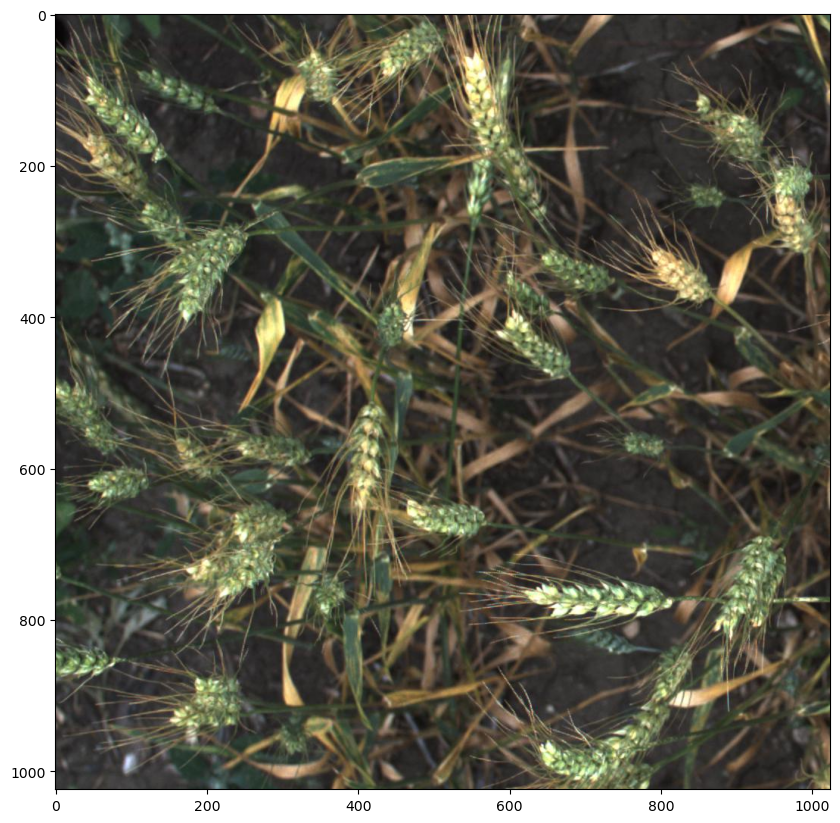

In [6]:
# plot the first image
import cv2

image = train.loc[0,'image_id']

image = os.path.join("train",image + ".jpg")

plt.figure(figsize=(10,15))
img = cv2.imread(image)   
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.imshow(img)    


- We can see clearly, wheat is present multiple times in the image

In [7]:
# check the size of the image
from PIL import Image

img=Image.open(image)
w,h=img.size    # w=Width and h=Height
print("Width =",w,end="\t")
print("Height =",h)

Width = 1024	Height = 1024


- This is something we had checked earlier also, all the images are of size 1024 by 1024

In [8]:
# bounding boxes are given as a string, convert them into list
train.bbox = train.bbox.apply(ast.literal_eval)
train.bbox.head()

0     [834.0, 222.0, 56.0, 36.0]
1    [226.0, 548.0, 130.0, 58.0]
2    [377.0, 504.0, 74.0, 160.0]
3    [834.0, 95.0, 109.0, 107.0]
4    [26.0, 144.0, 124.0, 117.0]
Name: bbox, dtype: object

In [9]:
# group the records by image id, so that we have cordinates of all the objects present in an image 
# as list of lists, name the new colum as bboxes
train = train.groupby("image_id")["bbox"].apply(list).reset_index(name="bboxes")

In [10]:
# check the updated dataset
train.head()

,image_id,bboxes
0,00333207f,"[[0, 654, 37, 111], [0, 817, 135, 98], [0, 192..."
1,005b0d8bb,"[[765.0, 879.0, 116.0, 79.0], [84.0, 539.0, 15..."
2,006a994f7,"[[437.0, 988.0, 98.0, 36.0], [309.0, 527.0, 11..."
3,00764ad5d,"[[89.0, 256.0, 113.0, 107.0], [216.0, 282.0, 1..."
4,00b5fefed,"[[709.0, 97.0, 204.0, 105.0], [775.0, 250.0, 1..."


In [11]:
# train test split
df_train,df_valid = model_selection.train_test_split(
    train,
    test_size=0.1,
    random_state=42,
    shuffle=True
)

In [12]:
# drop the index
df_train = df_train.reset_index(drop=True)
df_valid = df_valid.reset_index(drop=True)

In [13]:
print(os.getcwd())

c:\Users\ACHRAF FAYTOUT\OneDrive\Documents\Github\count_wheat


In [24]:
# create folders to meet yolo requirement
'''
# in the cmd
    cd ./yolov5
    mkdir output 
    cd output
    mkdir images
    mkdir labels
    cd images
    mkdir train
    mkdir validation
    cd ..
    cd labels
    mkdir train
    mkdir validation
    cd ../
'''

0

In [14]:
# plot the folder structure created above
!tree ./yolov5/output /A

Folder PATH listing
Volume serial number is 0000008B 32C4:4F66
C:\USERS\ACHRAF FAYTOUT\ONEDRIVE\DOCUMENTS\GITHUB\COUNT_WHEAT\YOLOV5\OUTPUT
+---images
|   +---train
|   \---validation
\---labels
    +---train
    \---validation


In [15]:
# Define path
DATA_PATH ="" # this is where training and test images are saved
OUTPUT_PATH = "./yolov5/output/" 
IMG_SIZE = 1024
label = 0
EPOCHS = 20
BATCH_SIZE = 8

In [16]:
# helper function to convert the data into yolo format
# also copy images from train/test folder to yolov5 folder

def process_data(data,data_type=train):
    for _,row in tqdm(data.iterrows()):
        image_name = row.image_id
        bounding_boxes = row.bboxes
        
        yolo_data = []

        for bbox in bounding_boxes:
            x = bbox[0]
            y = bbox[1]
            w = bbox[2]
            h = bbox[3]
            
            x_center = x + w/2
            y_center = y + h/2
            
            x_center, y_center, w, h = tuple(map(lambda x: x/IMG_SIZE, (x_center, y_center, w, h)))
            yolo_data.append([label,x_center,y_center,w,h])
            
        yolo_data = np.array(yolo_data)
        np.savetxt(
        os.path.join(OUTPUT_PATH,f"labels/{data_type}/{image_name}.txt"),
            yolo_data,
            fmt=["%d","%f","%f","%f","%f"]
        )
            
        shutil.copyfile(
        os.path.join(DATA_PATH,f"train/{image_name}.jpg"),
        os.path.join(OUTPUT_PATH,f"images/{data_type}/{image_name}.jpg"),
        )

In [17]:
# execute above function
process_data(df_train,data_type="train")
process_data(df_valid,data_type="validation")

3035it [00:12, 237.99it/s]
338it [00:01, 225.04it/s]


In [18]:
# verify whether images copied correctly or not
train_images= glob("./yolov5/output/images/train/*.jpg")
validation_images= glob("./yolov5/output/images/validation/*.jpg")
print("no. of training images copied:{},\nno. of test images copied:{}".format(len(train_images),len(validation_images)))

no. of training images copied:3035,
no. of test images copied:338


In [19]:
# verify whether labels are saved correctly or not
train_labels= glob("./yolov5/output/labels/train/*.txt")
validation_labels= glob("./yolov5/output/labels/validation/*.txt")
print("no. of training labels saved:{},\nno. of test labels copied:{}".format(len(train_labels),len(validation_labels)))

no. of training labels saved:3035,
no. of test labels copied:338


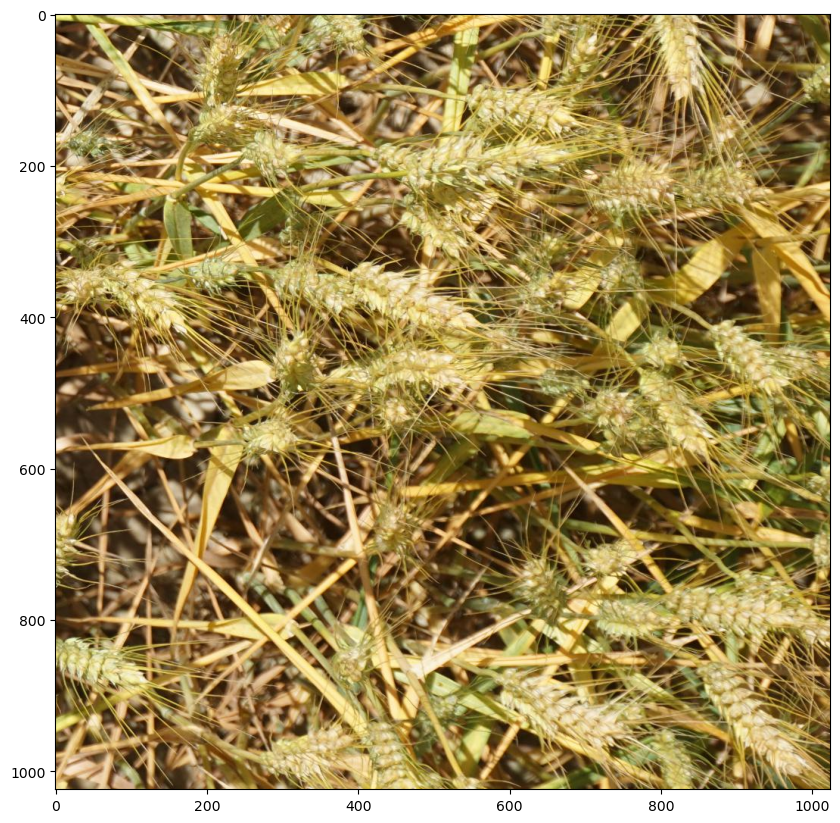

In [20]:
# check the first image saved in the yolov5 folder
import cv2

image = train_images[0]

plt.figure(figsize=(10,15))
img = cv2.imread(image)   
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.imshow(img)    


- So far so good, We have coppied the images to yolov5 folder

In [21]:
# verify the text file saved
!powershell Get-Content ./yolov5/output/labels/train/00333207f.txt -Head 10

0 0.018066 0.692871 0.036133 0.108398
0 0.065918 0.845703 0.131836 0.095703
0 0.010742 0.227051 0.021484 0.079102
0 0.034668 0.352539 0.061523 0.037109
0 0.120117 0.365723 0.080078 0.079102
0 0.052734 0.312988 0.046875 0.047852
0 0.206055 0.334961 0.068359 0.052734
0 0.205566 0.147949 0.067383 0.049805
0 0.218750 0.078613 0.041016 0.083008
0 0.046387 0.166992 0.086914 0.056641


- We have correctly saved the labels to the yolov5 folder
- Now we need to create yaml file

In [22]:
# Create yaml file, mention the path where training and validation data resides
# Also mention the no. of classes
# And Name the label to predict

OUTPUT_PATH = "./output"
with open(f"./yolov5/ws_data.yaml", "w+") as file_:
        file_.write(
            f"""
            
            train: {OUTPUT_PATH}/images/train
            val: {OUTPUT_PATH}/images/validation
            nc: 1
            names: ["wheat"]
            
            """
        )

In [23]:
# verify yaml file
!type .\yolov5\ws_data.yaml


            
            train: ./output/images/train
            val: ./output/images/validation
            nc: 1
            names: ["wheat"]
            
            


In [24]:
# helper function to train the yolo v5 model
def trainYoloModel(model_name: str,preTrainedWeights_path = None):
    """
    Helper function to train YOLO v5 models
    
    """
    mapper = {}
    for idx, model_ in enumerate(glob("yolov5/models/*yaml")):
        mapper[idx + 1] = model_
        print(f"{idx + 1} =>  {model_.split('/')[-1].split('.')[0]}")

    model = mapper[2]
    
    if preTrainedWeights_path is not None:
        os.system(
            """
                python yolov5/train.py --img {IMG_SIZE} --batch {BATCH_SIZE} --epochs {EPOCHS} --data yolov5/ws_data.yaml --cfg {model} --name {model_name} --weights {preTrainedweights_path}
            
            """
        )
    else:
        os.system(
            """
                python yolov5/train.py --img {IMG_SIZE} --batch {BATCH_SIZE} --epochs {EPOCHS} --data yolov5/ws_data.yaml --cfg {model} --name {model_name}
            """
        )

In [25]:
trainYoloModel(model_name = "ws_yolov5",preTrainedWeights_path = None)

1 =>  models\yolov5l
2 =>  models\yolov5m
3 =>  models\yolov5n
4 =>  models\yolov5s
5 =>  models\yolov5x


In [27]:
!tree ./yolov5/runs /A

Folder PATH listing
Volume serial number is 0000004C 32C4:4F66
C:\USERS\ACHRAF FAYTOUT\ONEDRIVE\DOCUMENTS\GITHUB\COUNT_WHEAT\YOLOV5\RUNS
Invalid path - \USERS\ACHRAF FAYTOUT\ONEDRIVE\DOCUMENTS\GITHUB\COUNT_WHEAT\YOLOV5\RUNS
No subfolders exist 



In [27]:
# helper function to make predictions
def predict(images_path:"path to the test images", weights_path: "path to the weights folder"):
    """
    Helper function to make predictions over images using Yolo
    """
    os.system(
        f"""
            python yolov5/detect.py --source {images_path} --weights {weights_path}
        """)

predict(images_path = "../input/global-wheat-detection/test",
       weights_path = "yolov5/runs/train/ws_yolov5/weights/best.pt")

detect: weights=['yolov5/runs/train/ws_yolov5/weights/best.pt'], source=../input/global-wheat-detection/test, data=yolov5/data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=yolov5/runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-376-g48a8531 Python-3.7.12 torch-1.11.0 CUDA:0 (Tesla P100-PCIE-16GB, 16281MiB)

Fusing layers... 
YOLOv5s summary: 213 layers, 7012822 parameters, 0 gradients
image 1/10 /kaggle/input/global-wheat-detection/test/2fd875eaa.jpg: 640x640 29 wheats, Done. (0.008s)
image 2/10 /kaggle/input/global-wheat-detection/test/348a992bb.jpg: 640x640 39 wheats, Done. (0.007s)
image 3/10 /kaggle/input/global-wheat-detection/test/51b3e36ab.jpg: 640x640 27 wheats, Done. (0.008s)
image 4/10 /kag

In [28]:
# images with bounding box boundaries saved in exp folder
!tree -f yolov5/runs/detect/exp

yolov5/runs/detect/exp
├── yolov5/runs/detect/exp/2fd875eaa.jpg
├── yolov5/runs/detect/exp/348a992bb.jpg
├── yolov5/runs/detect/exp/51b3e36ab.jpg
├── yolov5/runs/detect/exp/51f1be19e.jpg
├── yolov5/runs/detect/exp/53f253011.jpg
├── yolov5/runs/detect/exp/796707dd7.jpg
├── yolov5/runs/detect/exp/aac893a91.jpg
├── yolov5/runs/detect/exp/cb8d261a3.jpg
├── yolov5/runs/detect/exp/cc3532ff6.jpg
└── yolov5/runs/detect/exp/f5a1f0358.jpg

0 directories, 10 files



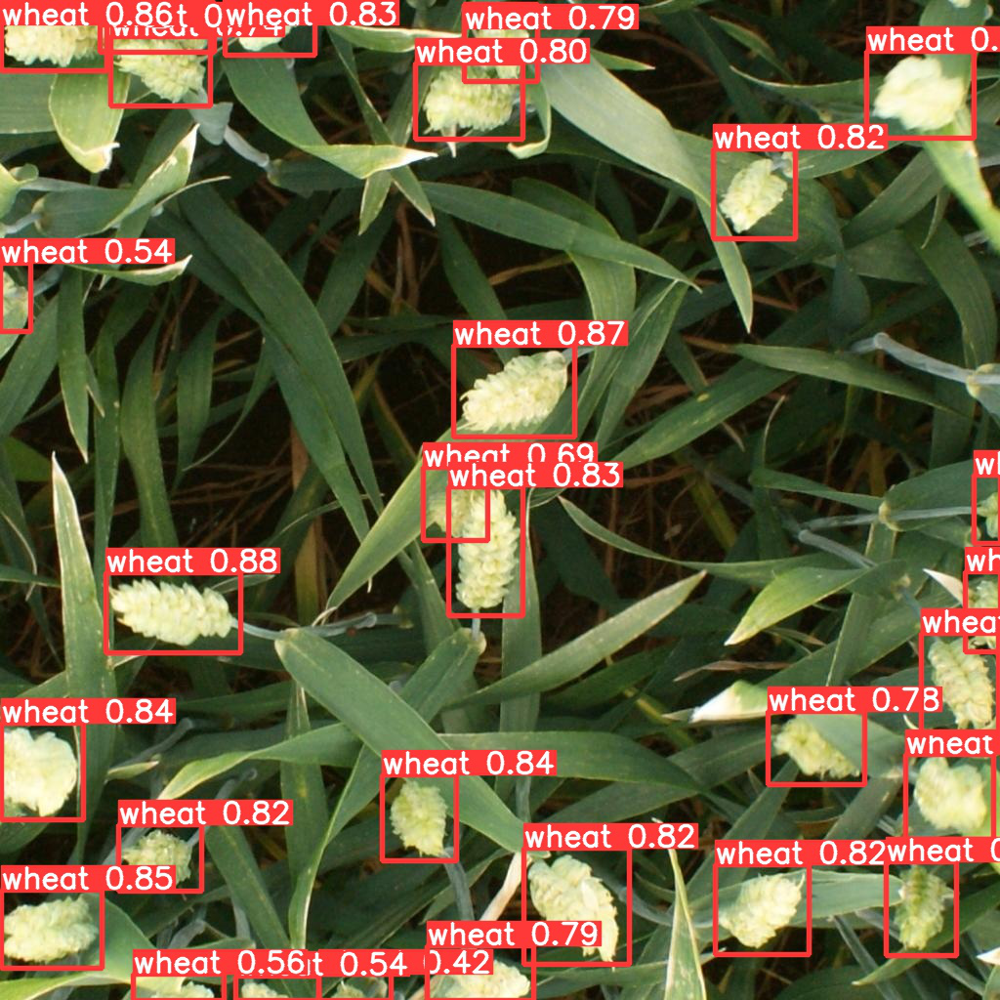


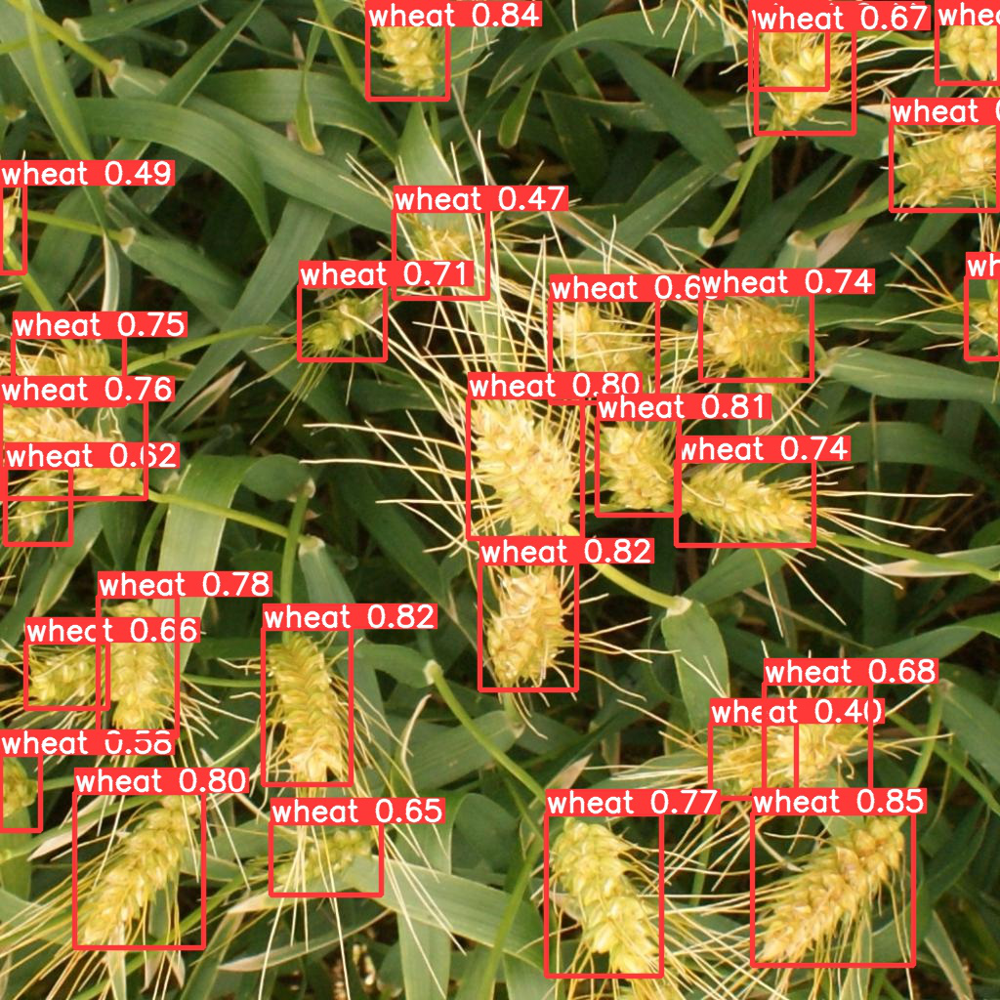


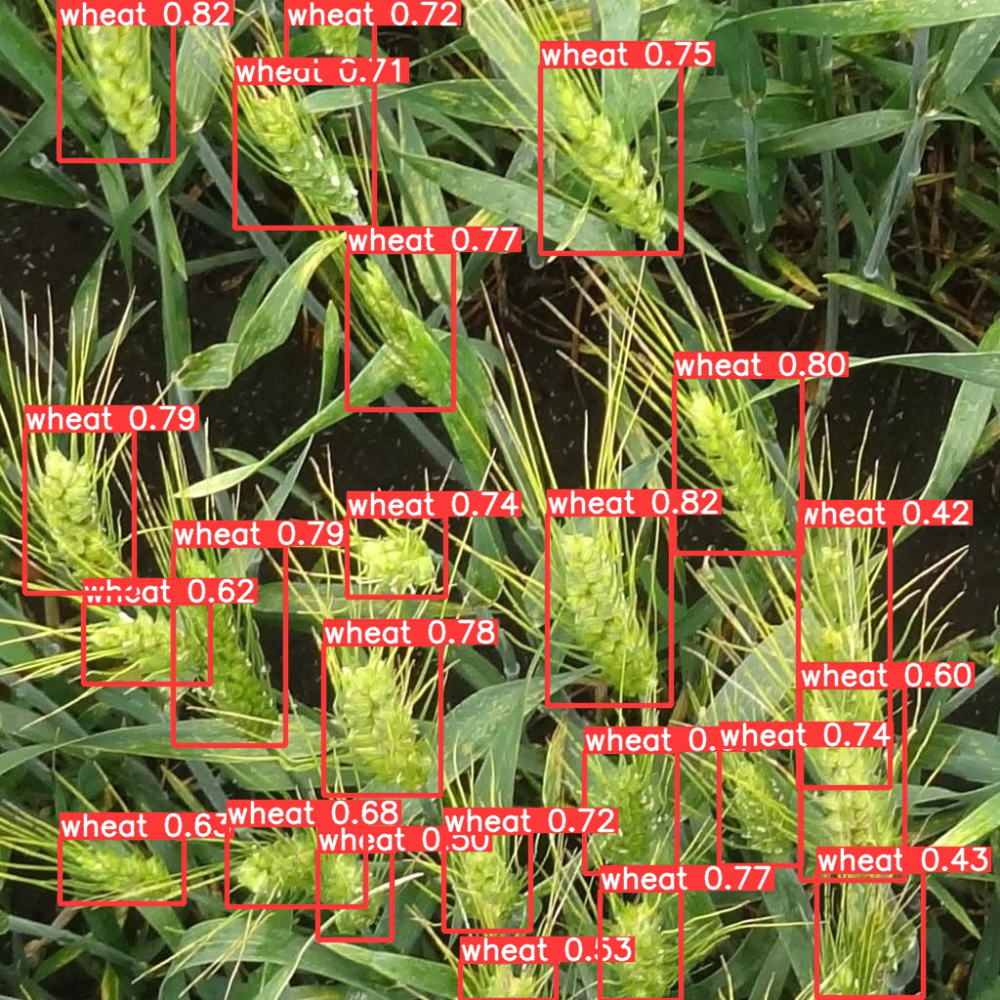


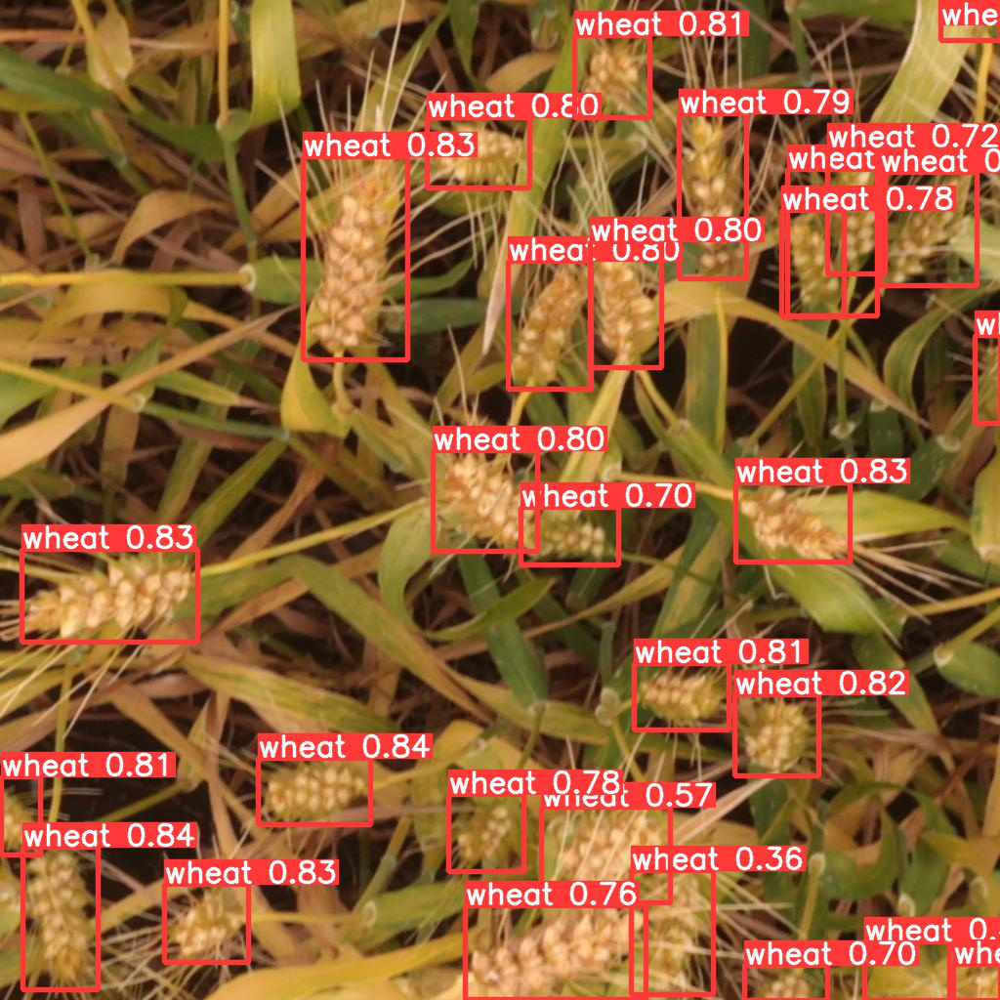


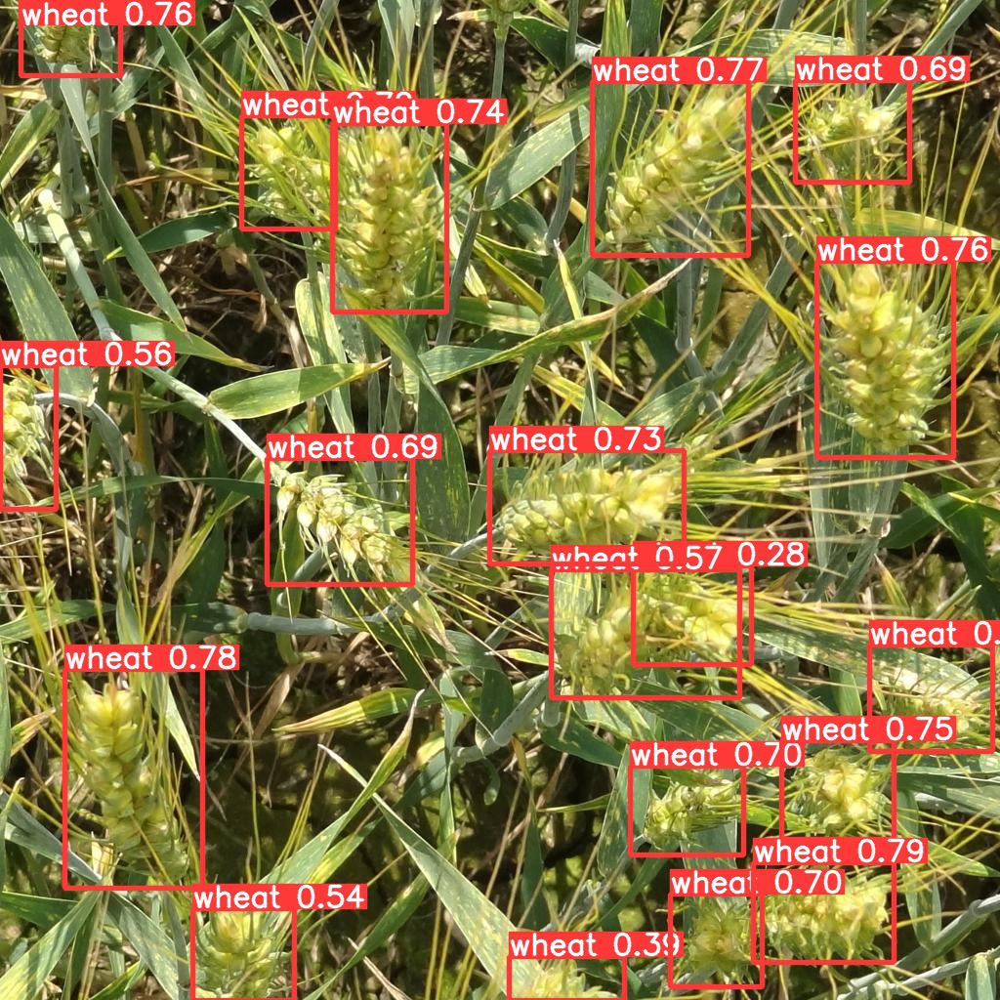


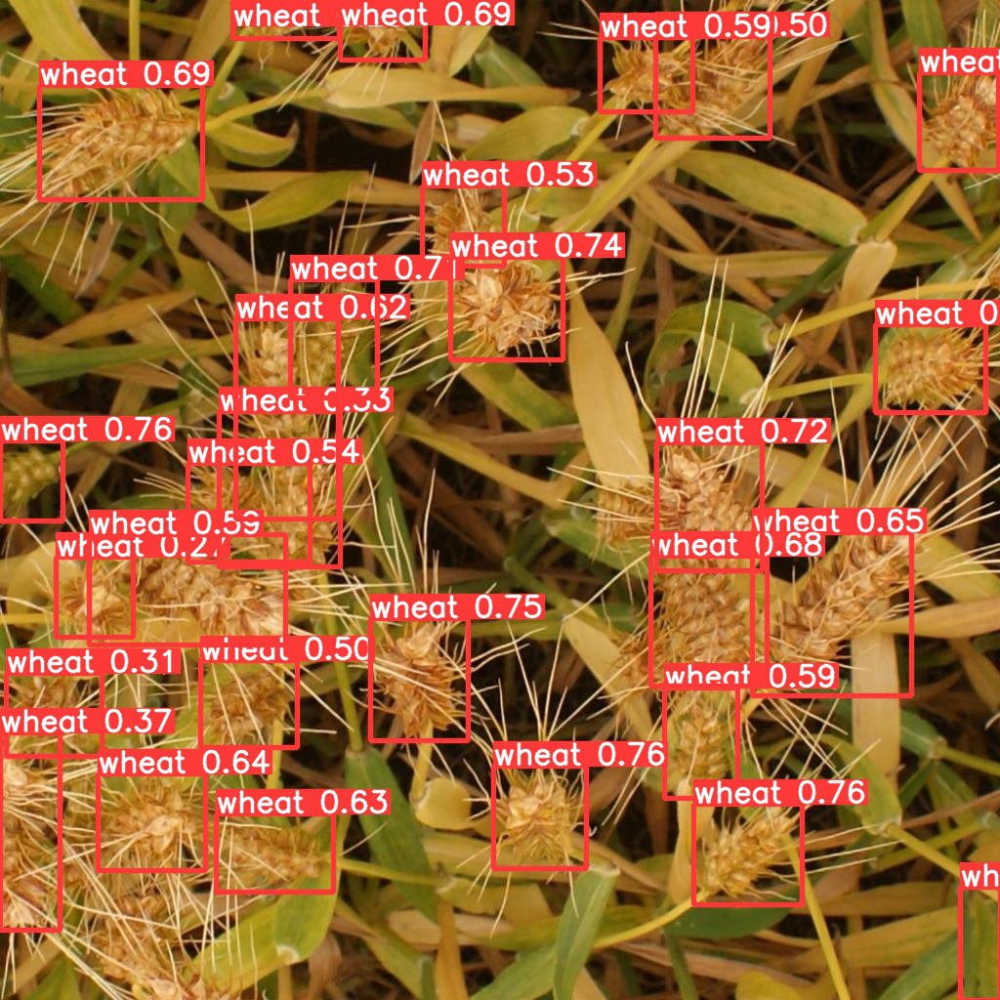


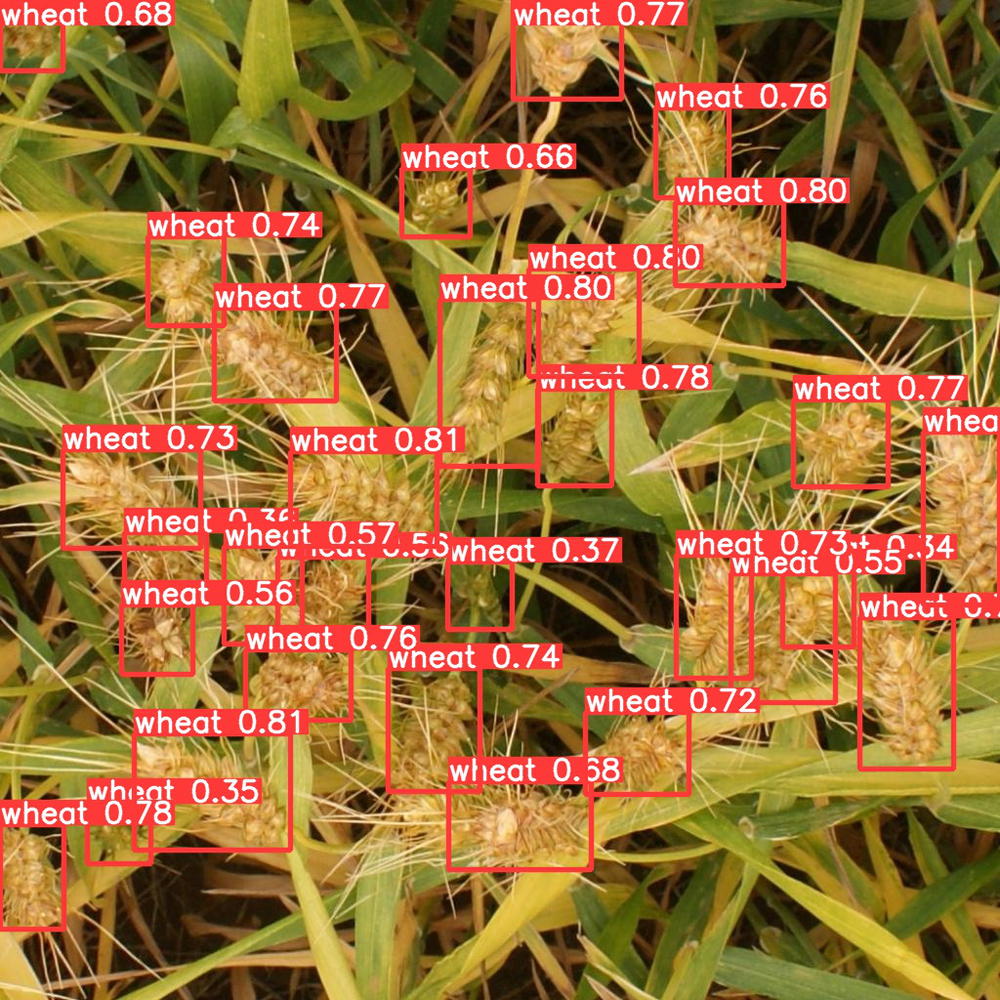


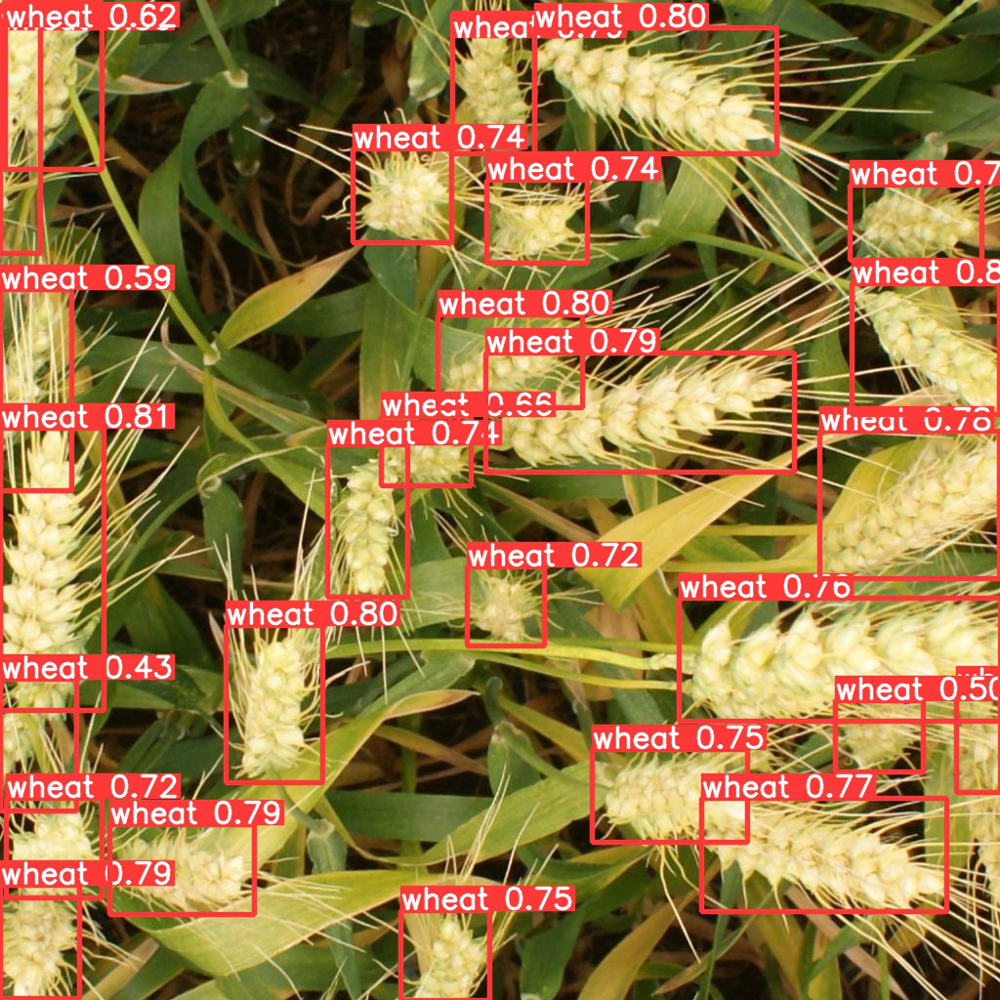


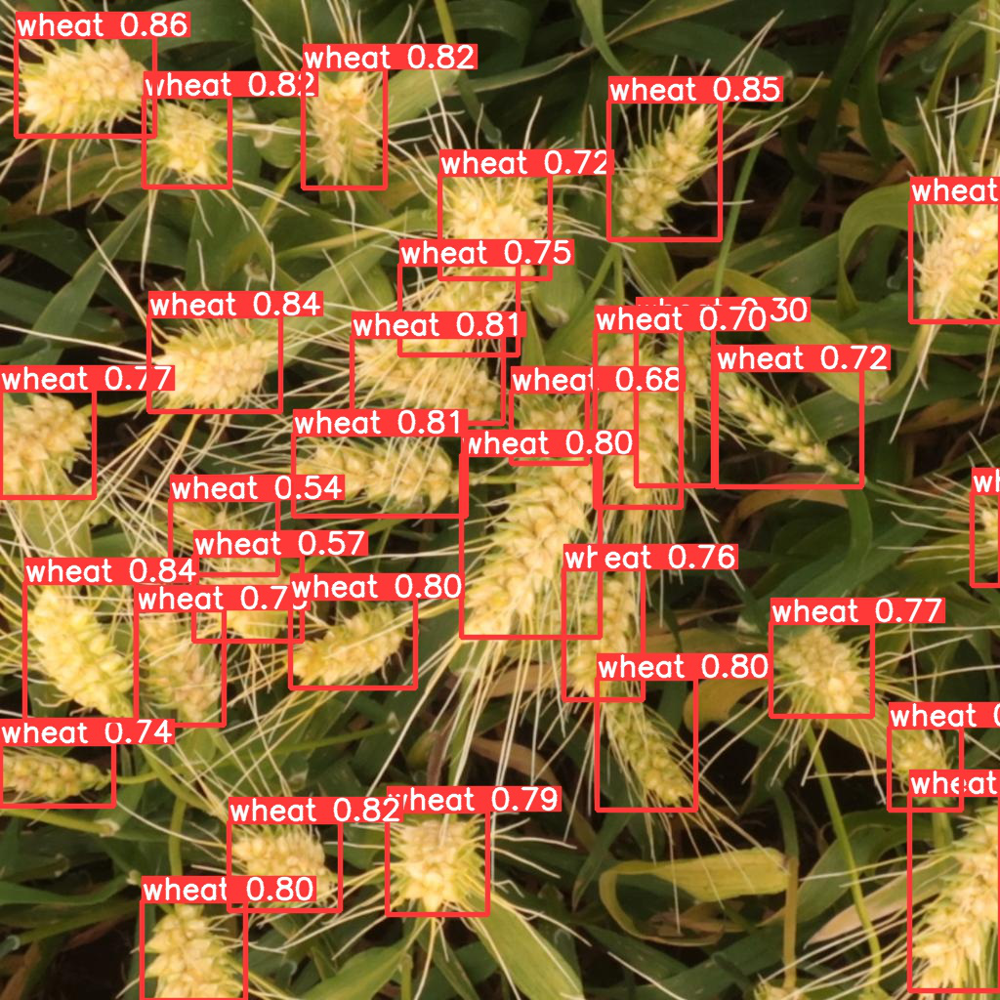


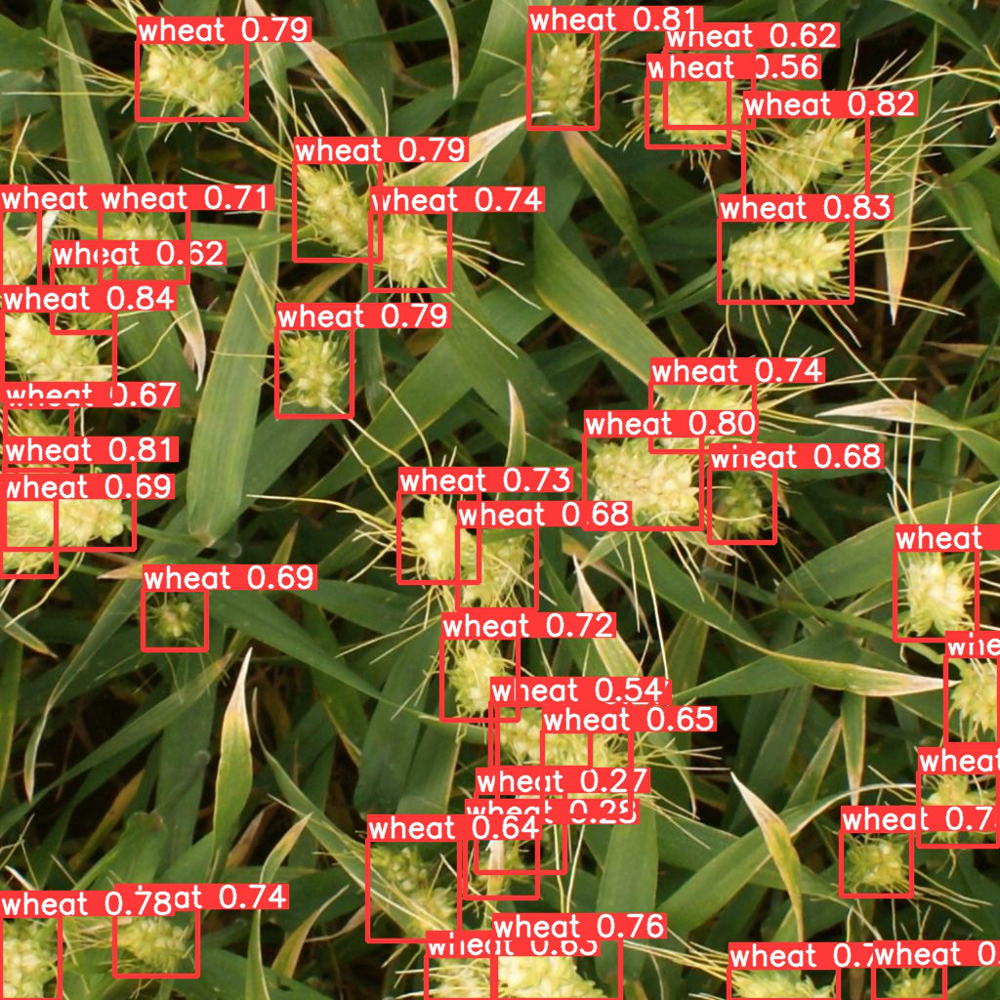

In [29]:
# plot images with objects detected
from skimage import io
import plotly.express as px
import plotly.graph_objs as go

def showImages(image_dir: "path to image directory"):
    """
    Helper function to visualize images in a directory
    
    """
    imgs_paths = glob(image_dir + "/*jpg")
    numImgs = len(imgs_paths)
   
    for i in range(numImgs):
        img = io.imread(imgs_paths[i])
        fig = px.imshow(img)
        fig.show()

    
showImages(image_dir = "yolov5/runs/detect/exp")